# Module 5: Frequency analysis of extreme events

## Outline
* Introduction
    - Aim
    - Assumptions
* Graphic method
    - Probability plotting
    - Historical data
    - Outliers
* Analytical method
    - Frequency factor
    - Examples
* Final remarks
    - Assumptions revisited

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math
from scipy import stats

import warnings
warnings.filterwarnings('ignore')

## Introduction

One important motivation for studying and modeling the statistics of extremes is **to estimate probabilities of rare and potentially damaging events**, such as extremely large daily precipitation amounts that might cause flooding, low-flow extremes during droughts, or extremely large wind speeds or low temperatues that might cause damage to structures.

* Often extreme-value statistics are of interest because the physical processes generating extreme events, and the societal impacts that occur because of them, are large and unusual

* A typical example of extreme-value data is the collection of annual maximum, or block maximum (largest in a block of $m$ values), daily precipitation values.

You will see that this topic is closely related to **outlier detection** and **finding a theoretical distribution that fits your data**.


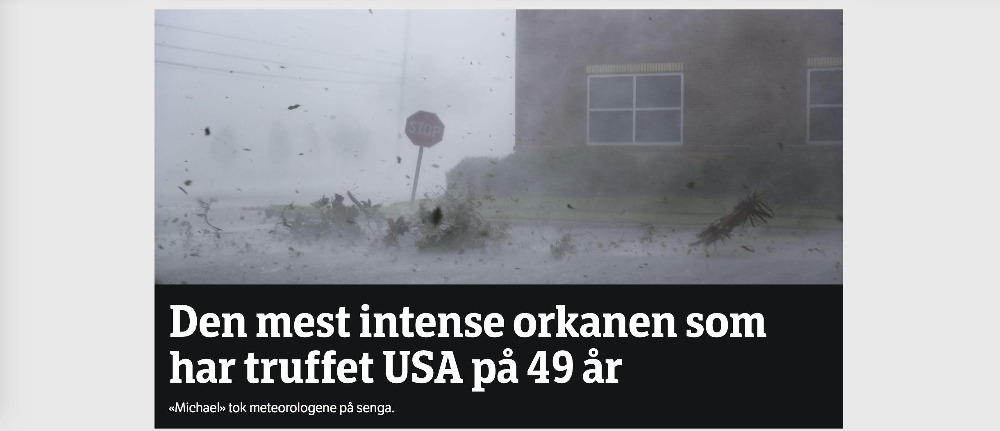

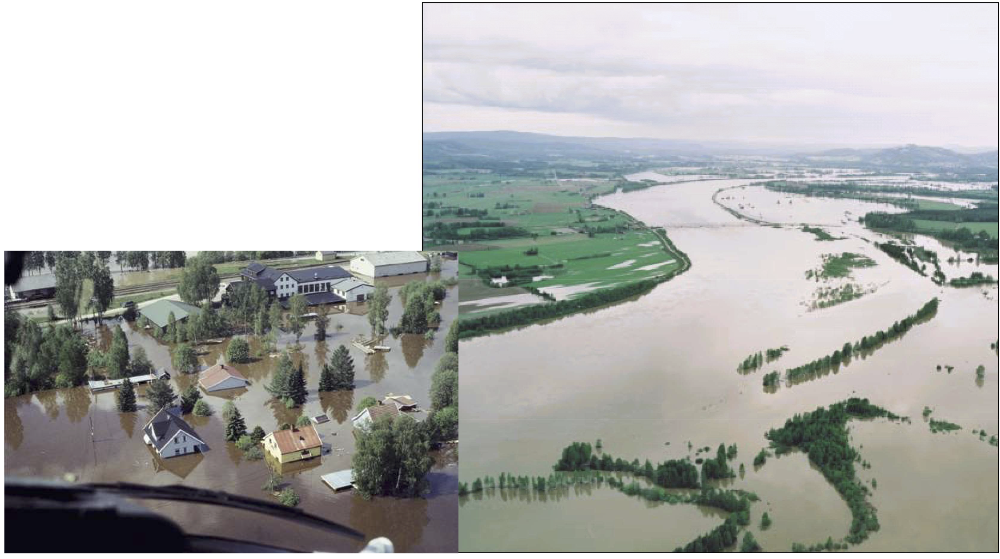

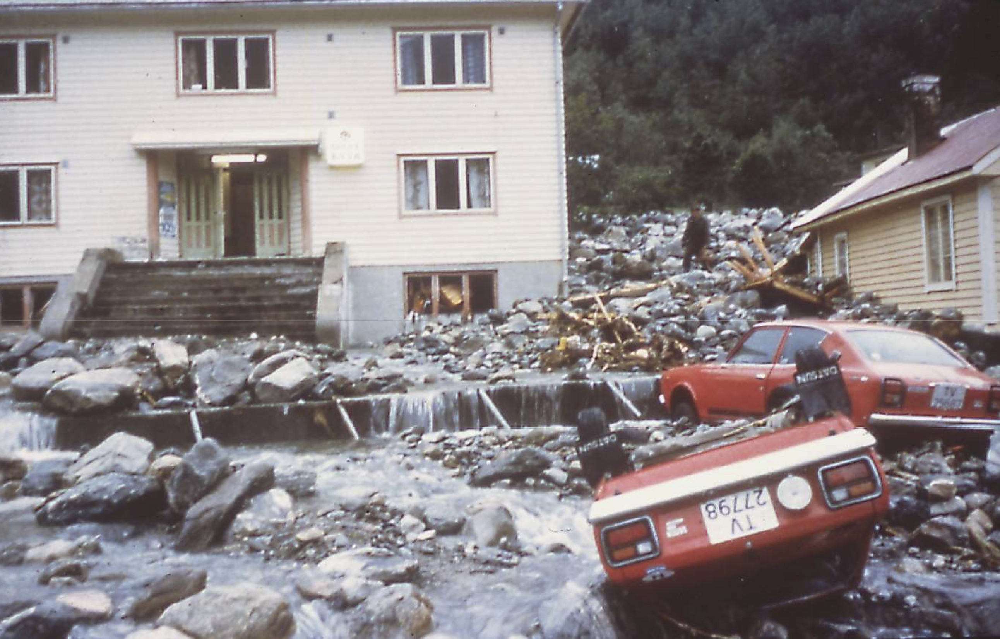

### Concepts

* Design event (e.g. flood or storm)
    - $X_T$ is the peak magnitude for a predetermined design level as measured by the return period $T$
* Return period $T$ is the average time between two events of a given magnitude, or greater
    - E.g.: the mean value of a series approximately has $T=2$
    - The smallest value has $T=1$
    - The largest value has $T \ge n$
    - (The 1910 flood in Paris was estimated to be a 100-year event, so newspapers in France raised great concern about the imminent arrival of the next severe flood in 2010)
* Exceedance probability $P(X>X_T)$ is the probability that a given event $X_T$ will be exceeded
* Non-exceedance probability $1-P(X>X_T)$
* By definition $T=1/P(X>X_T)$ (in the same units as time series)
* $Risk=1-(1-p)^N$


### Example design events

Required design flood estimates
* Dam safety: 1000-years flood
* Infrastructure: 200-years flood

In [10]:
# The risk of failure of an infrastructure over N=10 years
1./2

0.5

### Aim
We want to do statistical estimations of:
* the design events for a given return period
* the probability of exceedance of a given event, or its return period

We may sometimes be interested in the probability of events that are **more extreme than any previously observed event**:
* Then you trust that information about your design event is **statistically imprinted** in your data series
    - So information about a 100-year event can be imprinted in a 15-year dataset
    - But due to climate and land-use change, extremes may be **non-stationary**

** Today, we only talk about statistical analyses of extremes (and not process-based analyses). **

### Assumptions

For a meaningful statistical analysis, we have to make some assumptions to our data:
* Relevance: based on the relevant extreme (min, max)
* Unbiased, so your sample is representative for your population
* Homogeneity of your record
* Sufficiency
    - be able to estimate higher moments
    - n>25
    - (technically extreme value theory applies to an infinite number of observations)
    - include all *types of processes* that you expect to contribute to your design event
    - this assumption limits the frequency analysis for long return periods
* IID (independent and identically distributed)
    - deal with serial correlation
    
These assumptions need to be checked before you start your frequency analysis (or at least afterwards).

<IPython.core.display.Javascript object>


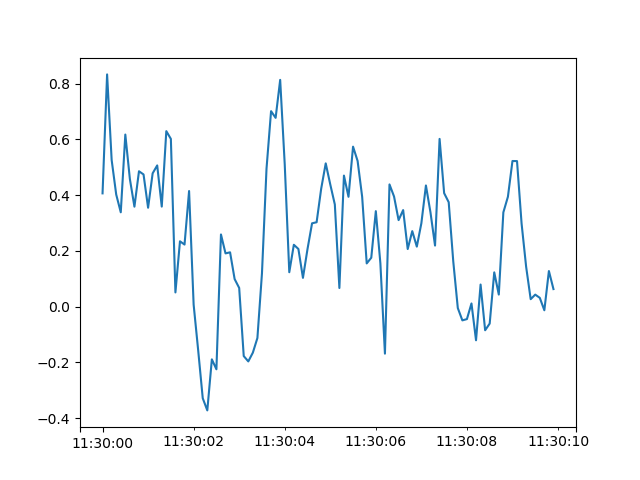

In [12]:
#let's load the wind data we used in lecture 2
df = pd.read_csv('2018-08-13T113000.csv',index_col=0,parse_dates=True)

#df.head()
df['w_m/s'].iloc[:100].plot()

### Checking for serial correlation (dependence)

* Autocorrelation:
$$\rho_L=cor(x_t,x_{t+L})=\frac{cov(x_t,x_{t+L})}{\sqrt{var(x_t)var(x_{t+L})}}$$

The autocorrelation describes **_linear_ temporal correlations**, which are particularly important in many geophysical systems (with "memory" or storage).


<IPython.core.display.Javascript object>


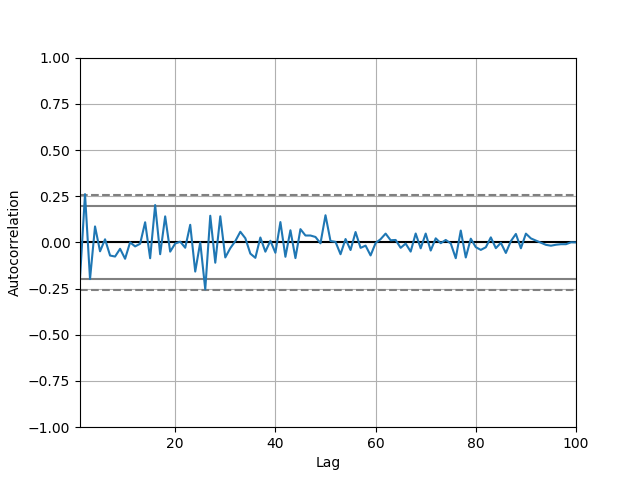

In [15]:
#check IID assumption

#pd.plotting.autocorrelation_plot(df['w_m/s'])
#plt.xscale('log')

pd.plotting.autocorrelation_plot(np.random.random(100))

<IPython.core.display.Javascript object>


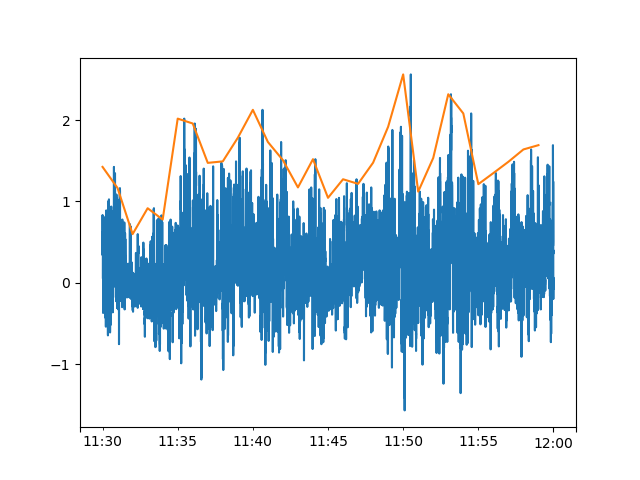

In [17]:
#take block maxima (let's say we were interested in large vertical gusts or "ejections")

maxdf=df.resample('60s').max()

df['w_m/s'].plot()
maxdf['w_m/s'].plot()

<IPython.core.display.Javascript object>


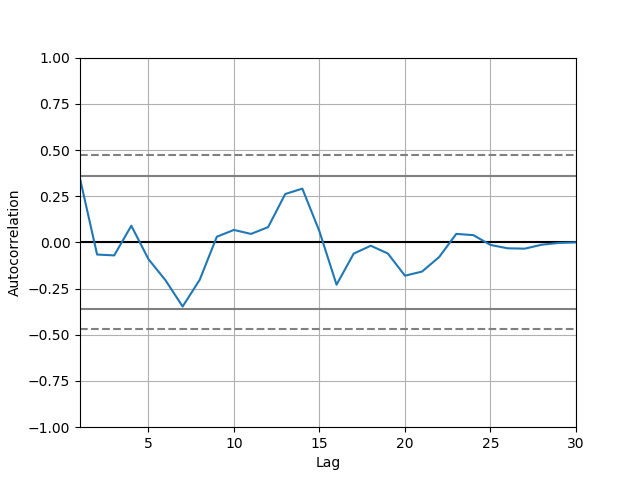

In [18]:
pd.plotting.autocorrelation_plot(maxdf['w_m/s'])

<IPython.core.display.Javascript object>


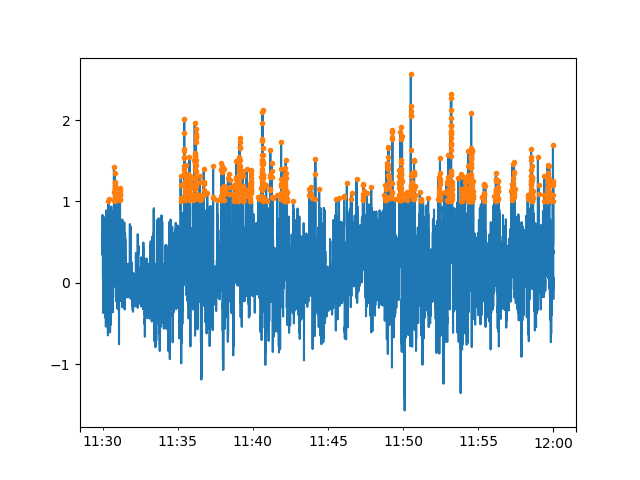

In [19]:
#get different extreme data using "peaks over threshold", to get a larger extreme value data set

pot_df=df.where(df['w_m/s']>1.)
df['w_m/s'].plot()
pot_df['w_m/s'].plot(style='.')

<IPython.core.display.Javascript object>


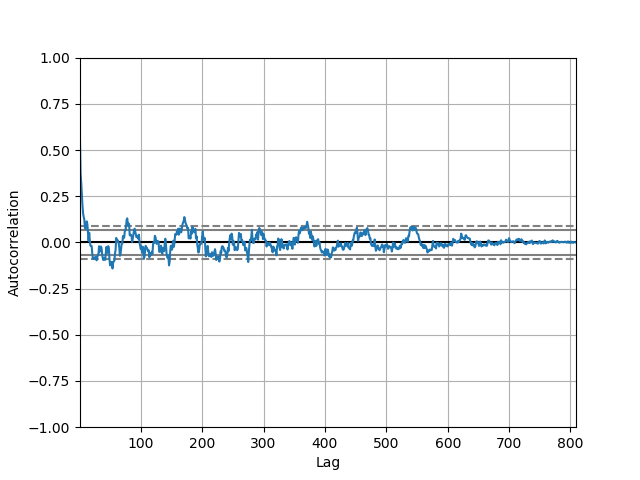

In [20]:
pd.plotting.autocorrelation_plot(pot_df['w_m/s'].dropna())


## Graphical method: Probability plotting

### Recipe
* Select an extreme value for each block of data
* Rank the data in decreasing order
* Assign a frequency/probablity of exceedance to each data point. Several formulas have been proposed, but the most common method is the Weibull formula:
$$P(X>X_m)=\frac{m}{n+1}$$


* Here, $m$ is the order/rank and $n$ the sample size. So $m(X_{max})=1$ and $m(X_{min})=n$
* Plot $X\sim P(X>X_m)$ (or $X \sim T=1/P(X>X_m)$)
* The return period unit is the duration of the block
* Choose distribution
    - Probability paper (axes scaled with assumed distribution): straight lines verify the fit to the assumed distribution
* Fit distribution to the data
* Evaluate the fit
* Read off $P$, $X_T$ or $T$ from the graph

In [21]:
#Example: assuming a normal distribution, estimate the exceedance probabilities, e.g. for X=25

rv1=np.array([12.7, 19.0, 16.9, 11.5, 14.3]) #5 points can be managed by hand on probability paper

df2=pd.DataFrame()
df2['rv1']=rv1

print(df2)

    rv1
0  12.7
1  19.0
2  16.9
3  11.5
4  14.3


In [22]:
#df2.sort_values(['rv1'],inplace=True)

df2['rank']=df2.rank(ascending=False)

df2['P_exceed']=df2['rank']/(df2['rv1'].count()+1) *100.

print(df2)

#df2.plot.scatter(y='P_exceed',x='rv1')

    rv1  rank   P_exceed
0  12.7   4.0  66.666667
1  19.0   1.0  16.666667
2  16.9   2.0  33.333333
3  11.5   5.0  83.333333
4  14.3   3.0  50.000000


<IPython.core.display.Javascript object>


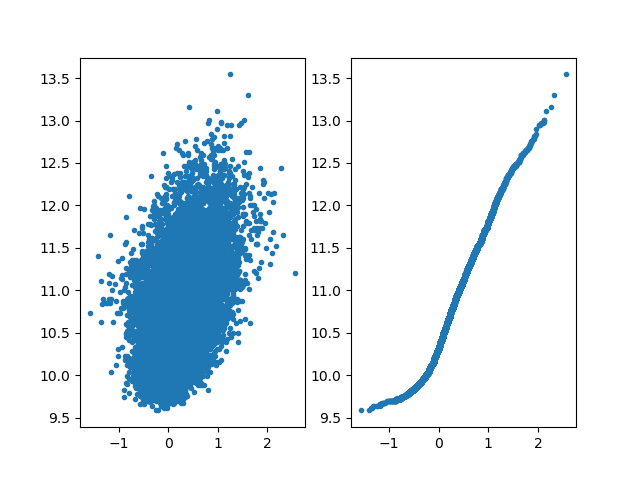

In [25]:
# QQ plot to compare two sample distributions (without assuming a theoretical distribution)

#x = np.random.normal(loc=20., scale=2., size=500)
#y = np.random.normal(loc=1.5,scale=0.3, size=500)
#y = np.random.exponential(scale=3., size=500)

x=df['w_m/s']
y=df['T_degC']


ax1=plt.gcf().add_subplot(121)
ax2=plt.gcf().add_subplot(122)
ax1.plot((x),(y),'.')
ax2.plot(np.sort(x),np.sort(y),'.')


### Using historical data

Hydrological/meteorological challenge: Limited data
* Longest time series: 122 years
* More often: 30-40 years of data

Using historical data outside the systematic record
* Paleohydrologic record
* Newspapers, books
* Norway: public reviews of flood damages for individual farms resulting in tax reduction
* Perception thershold might evolve in time
     - How vulnerable is the soiciety?

Flood marks
* Bridges
* Riverbanks
* Buildings
* Waterlevels

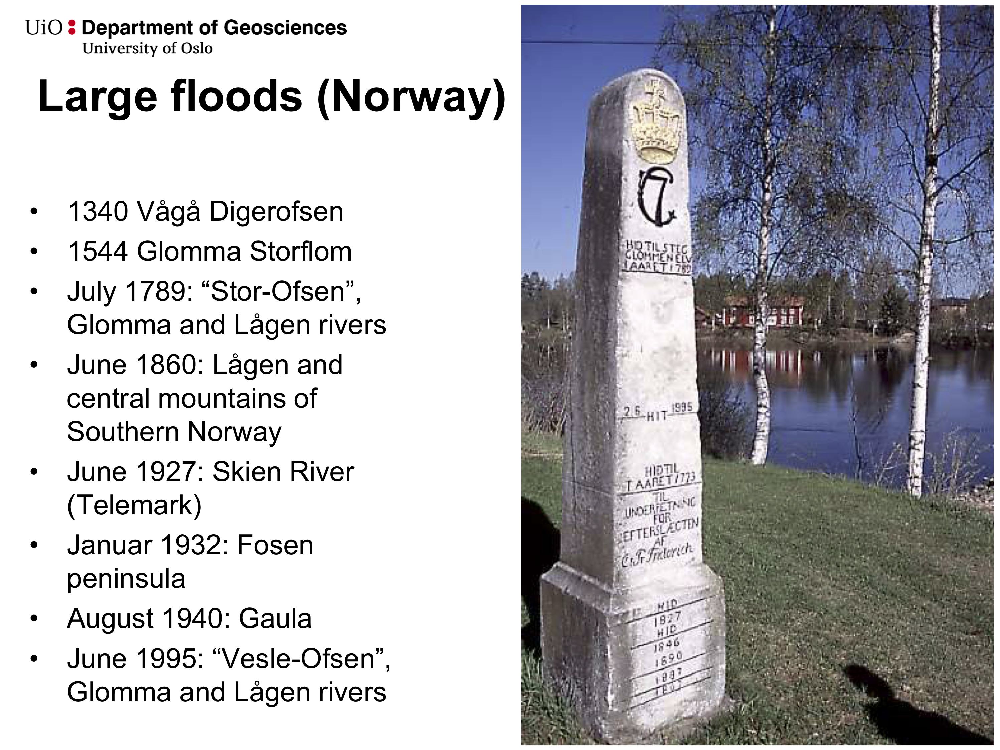

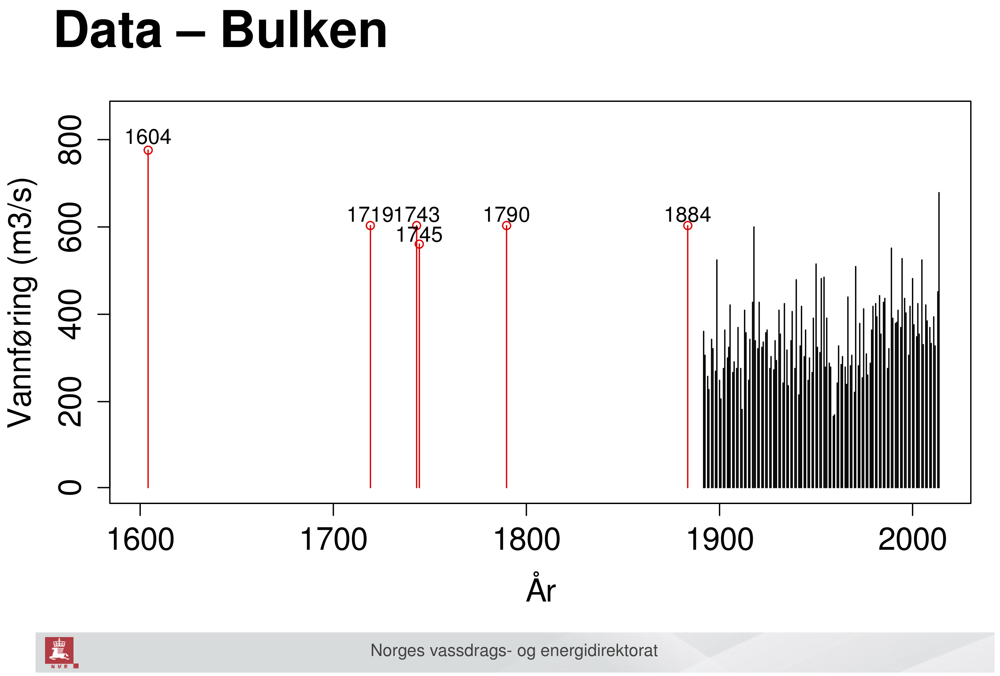

For the probability plot, we have to adjust the plotting positions with a weight $W$, taking into account the number of historic events $Z$, the length of the historic record $H$, and the length of the systematic record $N$ using
$$W=\frac{H-Z}{N}$$

The adjusted rank for the systematic data is
$$m_a=Wm-(W-1)(Z+0.5)$$

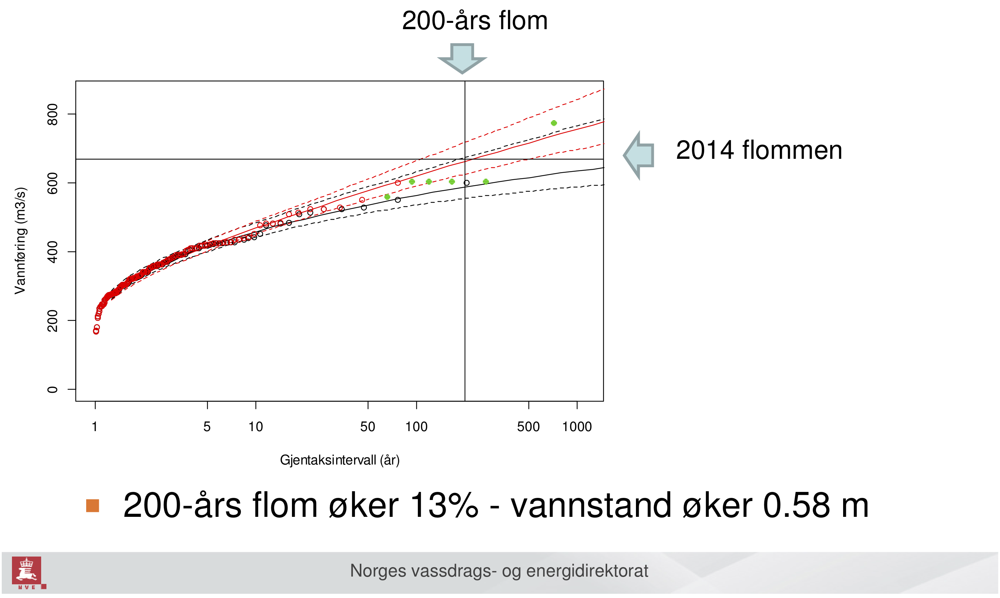

## Analytical method: using frequency factors

If you are willing to accept an underlying distribution, you can use a more analytical method.

Any random variable $X$ may be written as $X=\bar{x}+\Delta X$.

You may express $\Delta X$ in terms of the standard deviation $s$ and a frequency factor $K$:
$$K=\frac{\Delta X}{s}$$

For a design value $X_T$ you may write
$$X_T=\bar{x}+K_T s$$

or
$$X_T=\bar{x}(1+C_v K_T)$$

with the coefficient of variation $C_v$.

**The frequency factor $K_T$ depends on the assumed probability distribution and the set return period $T$.**

If $X \sim N(\mu,\sigma^2)$, $K_T$ becomes the standardised normal variate $Z_T=\frac{X_T-\mu}{\sigma} \sim N(0,1)$

Numpy, Wikipedia, or the appendix of your exam know the standard normal distribution table. https://en.wikipedia.org/wiki/Standard_normal_table#Cumulative

There are tables for $K_T$ that you can use to estimate $X_T$ from a data set (if $T$ is given), or $T$ (if $X_T$ is given).

#### Examples


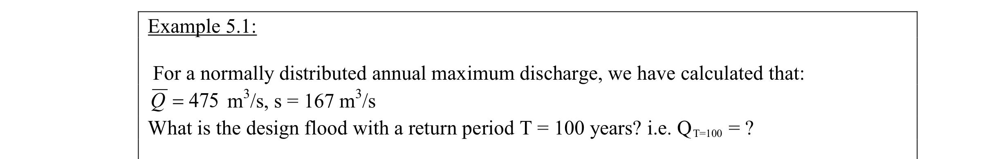

In [26]:
# T=100
# P(Q>QT)=1/T

# P(Q<QT)=1-P(Q>QT)=0.99
# Z=KT=2.33

475+2.33*167

864.11

### Outliers

You may think of an outlier as a 200-year event that is contained in a 10-year data record. There is *nothing wrong* with that data point, but your statistical analysis would be sensitive to including it. However, you need a good reason to exclude outliers, especially when they *go into the direction of the extreme you estimate*.

Outliers may be identified with these high and low thresholds:
$$X_H=\bar{X}+K_nS_X$$
$$X_L=\bar{X}-K_nS_X$$

with
$$K_n\approx 1.055+0.981 log_{10}n$$

#### Design example: Low-temperature extreme on Svalbard

You're designing a fleet of automatic weather stations that should run on Svalbard.
Sensor and datalogger specifications differ considerably in their low-temperature rating, as well as their prize. Typical rating classes are 5, 0, -20, -40, -50 degC.

Question: Which rating class should you chose? 

<IPython.core.display.Javascript object>


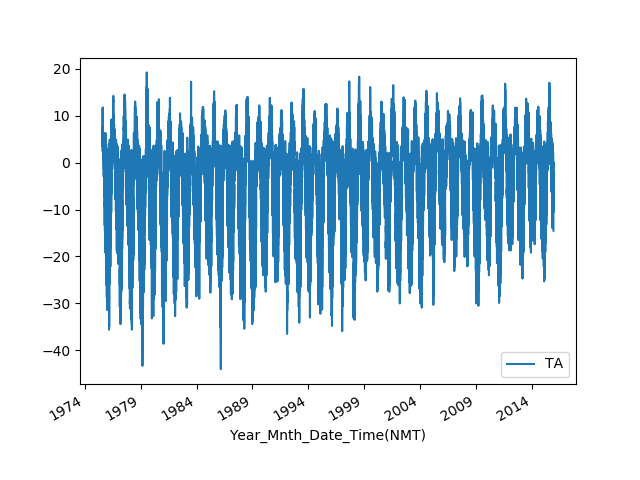

In [27]:
#You may use air temperatures recorded at Svalbard airport.
df = pd.read_csv('TA_LYR_airport.csv',index_col=0,parse_dates=True)

#df.head()
df.plot()

In [ ]:
pd.plotting.autocorrelation_plot(df['TA'].dropna())


### Extreme value distributions


We can construct a new time series by selecting only the extreme values. This new time series is _very_ skewed (has a long tail), and the appropriate curves to fit to this data are extreme value distributions.

> ** Extremal Types Theorem:** The largest of $m$ **independent** observations from a fixed distribution will follow the *generalized extreme value (GEV) distribution* increasingly closely as $m$ increases, regardless of the (**single, fixed**) distribution from which the observations have come

The Extremal Types Theorem is analog within the statistics of extremes of the Central Limit Theorem for the distribution of sums converging to the Gaussian distribution.

"It seems that the rivers know the theory. It only remains to convince the engineers of the validity of this analysis." -- Emil Gumbel

Three types of extreme value distributions exist, each having a heavy tail:

|       Gumbel                 |         Fréchet                 | Weibull                          |
|------------------------------|---------------------------------|----------------------------------|
|              (Type I)        |                 (Type II)       |         (Type III)               |
| Heavy tail to left and right |Heavy tail to the right (floods) | Heavy tail to the left (low-flow)|
| Annual maximum river flow    |                                 | Low-flow                         |

Gumbel:
$f(x)= \frac{1}{\sigma}e^{-z-e^{-z}}$

where $z = \frac{x-\mu}{\sigma}$

Fréchet:
$f(x)= \frac{\alpha}{\beta}\big(\frac{\beta}{x}\big)^{\alpha+1}e^{-(\beta/x)^\alpha}$,

where $\alpha, \beta > 0$

Weibull:
$f(x)= \frac{\alpha}{\beta}\big(\frac{x}{\beta}\big)^{\alpha-1}e^{-(x/\beta)^\alpha}$,

where $\alpha, \beta > 0$


<IPython.core.display.Javascript object>


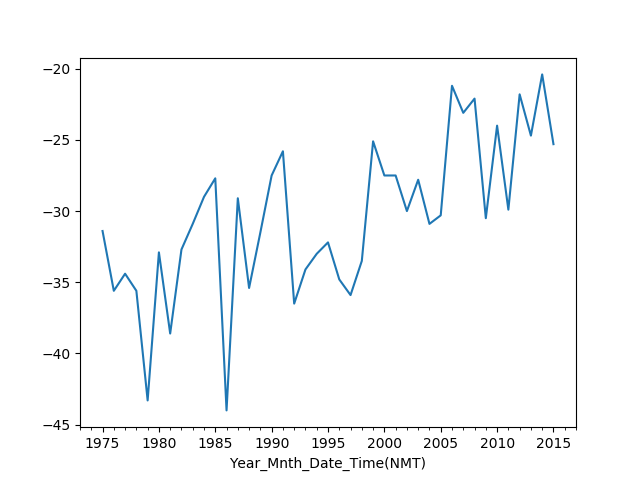

In [28]:
yr_min_df=df.resample('1A').min()
yr_min_df['TA'].plot()
#pd.plotting.autocorrelation_plot(yr_min_df['TA'])

Mean: -30.42682926829268
Std: 5.524673039657817


<IPython.core.display.Javascript object>


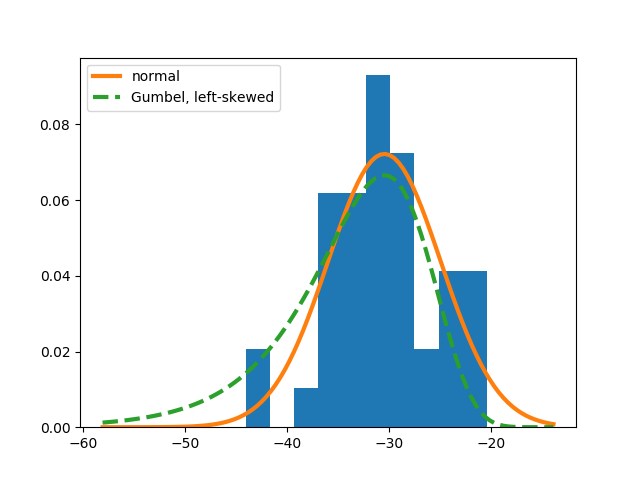

In [29]:
Tmean=yr_min_df['TA'].mean()
Tstd=yr_min_df['TA'].std()
print("Mean: "+str(Tmean))
print("Std: "+str(Tstd))

#find a distribution to assume

plt.hist(yr_min_df['TA'], normed = True)

x = np.linspace(Tmean-5*Tstd, Tmean+3*Tstd,100)

plt.plot(x, stats.norm.pdf(x, Tmean, Tstd), '-', linewidth=3, label='normal')
plt.plot(x, stats.gumbel_l.pdf(x, Tmean, Tstd), '--', linewidth=3, label='Gumbel, left-skewed')
plt.legend()


* In order to get a better fit of the probability distribution, the frequency analysis method may be applied to seasonal data. For example if you can show that the extreme values in different season may come from different origin and have different characters, it is then difficult to fit one distribution. Different seasons may have different distributions.

In [30]:
T=100.

KT=stats.norm.ppf(1./T) # ~ -2.33, for 100 year return period and normal distribution

KT_gumbel=-np.sqrt(6)/np.pi * ( 0.5772+np.log(np.log(T/(T-1))) ) #formula from compendium

#the design event becomes
TT=Tmean + KT*Tstd
TT_gumbel=Tmean - KT_gumbel*Tstd

print("100-year design event: "+str(TT))
print("100-year design event, using Gumbel: "+str(TT_gumbel))


100-year design event: -43.27914064887139
100-year design event, using Gumbel: -47.75596425424471


In [ ]:
print("The risk of exceeding the design event in a 10-year period: "+str(1-(1-1./100)**10))


<IPython.core.display.Javascript object>


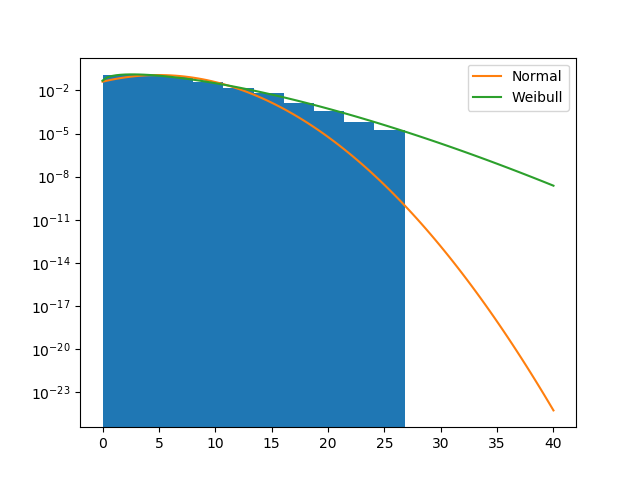

In [32]:
#you may also have a look at the wind speed record from the same station

FFdf = pd.read_csv('FF_LYR_airport.csv',index_col=0,parse_dates=True).dropna()

plt.hist(FFdf['FF'], normed = True)

x = np.linspace(0, 40,100)
plt.plot(x, stats.norm.pdf(x, FFdf['FF'].mean(), FFdf['FF'].std()), label='Normal')
plt.plot(x, stats.weibull_min.pdf(x, *stats.weibull_min.fit(FFdf['FF'])), label='Weibull')

plt.legend()

plt.yscale('log') #to really see what's going on


### Log-normal distribution

Let $X$ be lognormally distributed, so that $Y=log(X)$ is normally distributed.

In [ ]:
#data based on Example 5.2

df3=pd.DataFrame()
df3['x'] = np.random.lognormal(mean=6.1, sigma=0.34, size=1000)
df3['y']=np.log(df3['x'])

#print(df3)
df3.hist()


Let $T$ be a given return period. To calculate the design event $X_T$:

* Calculate $\bar{y}=1/n \sum y_i$ and $s_Y=\sqrt{\frac{\sum (y_i-\bar{y})^2 }{n-1}}$
* Find $K_T$ from the normal distribution table for the given $T$
* Calculate $Y_T=\bar{y}+K_T S_Y$
* Calculate $X_T=exp(Y_T)$

In [ ]:
#with T=100 and Y~N, the frequency factor K_T becomes 2.33

Y_T=6.1 + 0.34*2.33

X_T=np.exp(Y_T)

print(X_T)


Sometimes you may only have the mean and standard deviation of $x$, but not the actual raw data. Then you may use these formulas to calculate the mean and standard deviation of $y$:

$$\bar{y}=log(\frac{\bar{x}^2} {\sqrt{s_x^2+\bar{x}^2}})$$


$$s_y=\sqrt{log(\frac{s_x^2}{\bar{x}^2}+1)}$$

See for example, Example 5.2 of the compendium

### Other extreme value distributions: using $K_T$ tables

* Extreme value type I distribution
    - Example 5.3

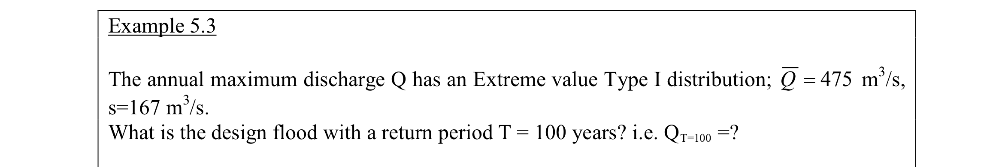

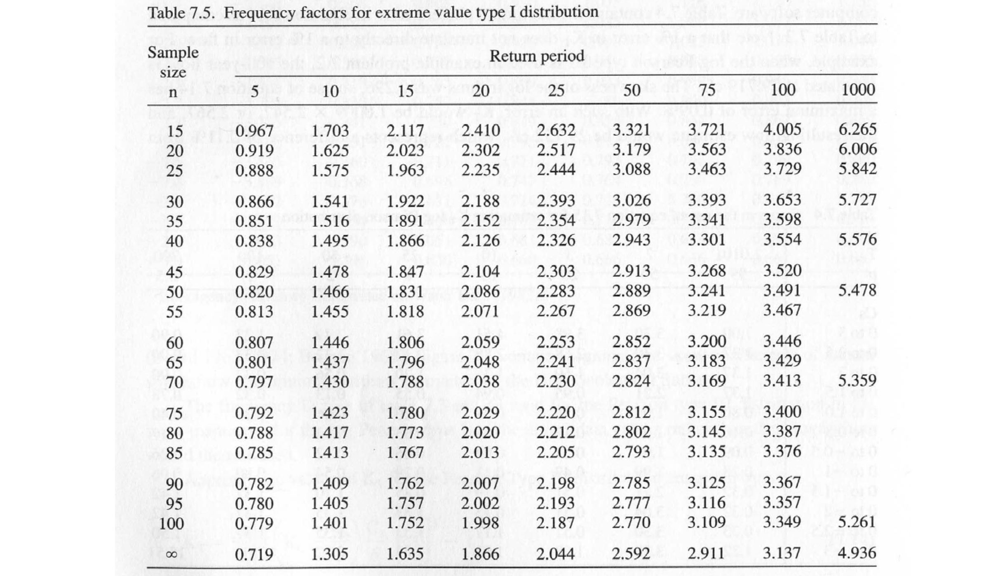

* Pearson Type III distribution
    - Example 5.4

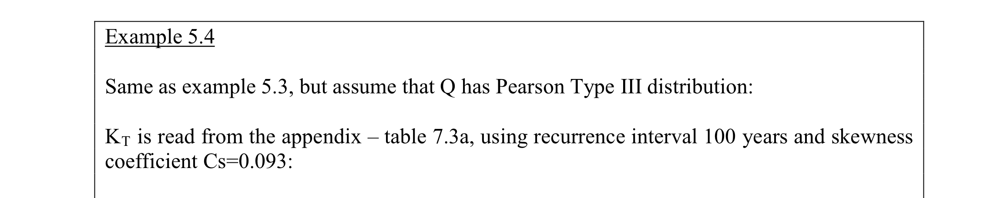

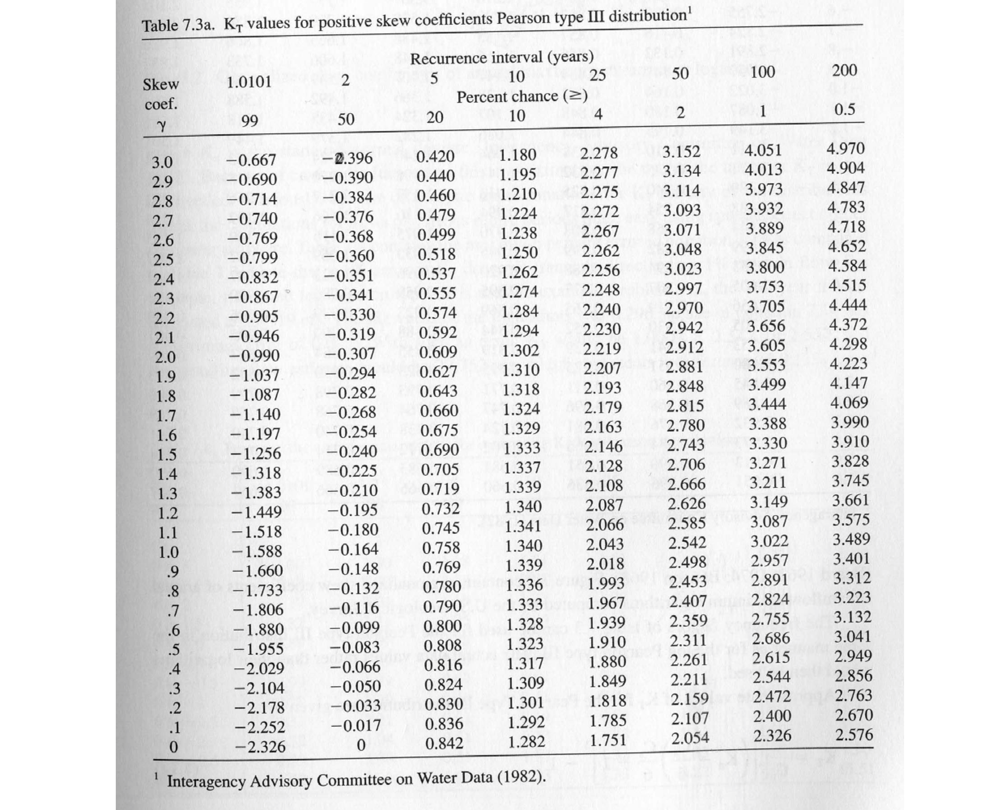


## Final remarks

The accuracy of your calculations will depend on
* how well your data fit the assigned probability distribution
* the lenght of your data series, i.e. extent of the extrapolation
    - you trust that information about your design event is *statistically imprinted* in your data series
    - due to climate and land-use change, extremes may be non-stationary

How do I know which distribution fits my data best?
* you get a straight line on probability paper
* the (cumulative) relative frequency curves of your dataset compare well with the theoretical distribution
* Goodness-of-fit testing